In [1]:
"""
Prediction file: Based on the trained neural network,see the performace on the testing set
Mapping Seed->Sim 

Here we are seeing the data demand requirement with changing training data size and observing the performance of the network 

General workflow
Load test data->Load multiple dilResNet models(trained with different number of images)and predict the output(are in latent representation) on test set-> 
Decode into higher dimensional representation using SD VAE-> Display 

"""

'\nPrediction file: Based on the trained neural network,see the performace on the testing set\nMapping Seed->Sim \n\nHere we are seeing the data demand requirement with changing training data size and observing the performance of the network \n\nGeneral workflow\nLoad test data->Load multiple dilResNet models(trained with different number of images)and predict the output(are in latent representation) on test set-> \nDecode into higher dimensional representation using SD VAE-> Display \n\n'

In [1]:
# import libs 
import os
import torch
import torch.nn as nn

import numpy as np
import matplotlib.pyplot as plt

import re
import pickle
import json
import matplotlib.ticker as ticker
from utils.config import FPATH

    
from models.vae import decode_img
from models.dilResNet import PDEArenaDilatedResNet
import pickle

from utils.config import SIMULATION_TEST_OUTPUT_FOLDER_TDB_2,SIMULATION_TEST_OUTPUT_FOLDER_2
from utils.config import LATENT_OUTPUT_SAVED,MODEL_SAVE_LOCATION, LOGS_SAVE_LOCATION
from utils.display import display_predictions_multiple_samples


from utils.preprocess import preprocess_simulation_output_data




/hpc/dctrl/ks723/miniconda3/envs/pytorch_PA_patternprediction/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


[2025-11-21 19:19:12,026] [INFO] [real_accelerator.py:110:get_accelerator] Setting ds_accelerator to cuda (auto detect)


/hpc/dctrl/ks723/miniconda3/envs/pytorch_PA_patternprediction/lib/python3.10/site-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [2]:
# prediction from testing dataset

'''
Loading test data for model testing

'''

path_output=SIMULATION_TEST_OUTPUT_FOLDER_TDB_2
path_input=SIMULATION_TEST_OUTPUT_FOLDER_2


## add some of the images from the main dataset that hasn't been used to train the network 

start_index = 70000  
end_index = 70100 
output_data=preprocess_simulation_output_data(path_output, start_index, end_index)

# input data

input_data=preprocess_simulation_output_data(path_input, start_index, end_index)  # both are simulations, so preprocess accordingly 


X=output_data
y=input_data

# size of input data is 32x32 and output data is 256x256
X=(np.array(X).reshape(-1,1,256,256)) #/255.0  # last one is grayscale first minus one is all x
y=(np.array(y).reshape(-1,1,256,256)) #/255.0

# normalizing images here to be bw 0 and 1 

X=X/255.0 
y=y/255.0
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

# Convert numpy arrays to torch tensors
X = torch.Tensor(X)
y = torch.Tensor(y)

y3=y.repeat(1, 3, 1, 1)
y4=y.repeat(1, 4, 1, 1)



In [3]:

# Example usage
model = PDEArenaDilatedResNet(
    in_channels=4,               # Input channels 
    out_channels=4,              # Output channels 
    hidden_channels=64,          # Number of hidden channels
    num_blocks=18,               # Number of dilated blocks 
    dilation_rates=[1, 2, 4, 8], # Dilation rates for multi-scale feature capture
    activation=nn.ReLU,          # Activation function
    norm=True
)


In [4]:
'''
Define pre-trained SD VAE for decoding orginal predicted patterns from the latent predicted patterns
dilResnet will predict latent representation of patterns 

'''

# Load the pre-trained VAE model

pickle_in=open(LATENT_OUTPUT_SAVED,"rb")
yprime_in=pickle.load(pickle_in)

yprime_in=yprime_in[start_index:end_index,:,:,:]

yprime_in = torch.Tensor(yprime_in)




Sorted filenames:
['Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_100_v1015-1760563648_best_tolerant.pt', 'Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_200_v1015-1760563648_best_tolerant.pt', 'Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_400_v1015-1760563648_best_tolerant.pt', 'Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_800_v1015-1760563648_best_tolerant.pt', 'Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_1600_v1015-1760563648_best_tolerant.pt', 'Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_3200_v1015-1760563648_best_tolerant.pt', 'Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_6400_v1015-1760563648_best_tolerant.pt', 'Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_12800_v1015-1760563648_best_tolerant.pt', 'Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_30000_v1015-1760563648_best_toleran

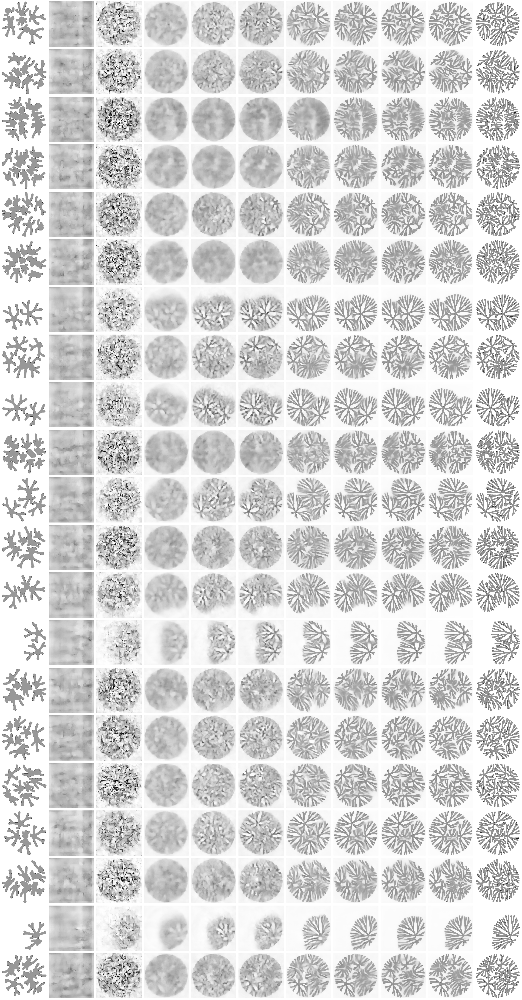

In [5]:
'''
Functions for selecting the appropriate ResNet and displaying their decoded predictions in a grid format with multiple samples 

'''

# Pattern to match filenames and extract the number of images used in training


pattern= r"Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_([\d]+)_v1015-([\d]+).*\.pt"

# Pixel_32x32x3to32x32x4_dilRESNET_newpatterns_intermediatetocomplex_1600_Test_Model_v325_Cluster_GPU_tfData-1742925802_best
def extract_number(filename):
    match = re.search(pattern, filename)
    if match:
        return int(match.group(1))  # Extract the number of images
    return float('inf')

# Directory containing the model files
directory = MODEL_SAVE_LOCATION  # Update this to your models' directory

# List all files and filter out those matching the pattern
filtered_filenames = [filename for filename in os.listdir(directory) 
                     if re.match(pattern, filename) and filename.endswith('_best_tolerant.pt')]

# Sort the filenames based on the number of images used in training
sorted_filenames = sorted(filtered_filenames, key=extract_number)

print("Sorted filenames:")
print(sorted_filenames)

# Initialize lists to collect predictions and number of samples
pred_images_list = []
num_samples_list = []

# Choose sample indices
sample_indices = list(range(21)) # Adjust as needed 0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20# Choose sample indices


# Get the input images and ground truths for the fixed samples
input_images = y3[sample_indices].cpu()  # Ensure tensors are on CPU
ground_truths = X[sample_indices].cpu()

# Loop through each model file
for filename in sorted_filenames:
    num_samples = extract_number(filename)
    num_samples_list.append(num_samples)
    
    print(f"Processing model trained with {num_samples} samples: {filename}")
    
    # Load the model
    model.load_state_dict(torch.load(os.path.join(directory, filename)))
    model.to(device)
    model.eval()
    
    with torch.no_grad():
        # Make predictions for the selected input images
        predicted_latents = model(yprime_in[sample_indices].to(device))
        # Decode the predictions
        pred_images = decode_img(predicted_latents)
        pred_images_list.append(pred_images.cpu())  # Move to CPU for plotting


'''
Displaying predictions for indices 0 to 20, seeing performance for many seeds

'''

# Call the plotting function
display_predictions_multiple_samples(input_images, ground_truths, pred_images_list, num_samples_list)

Processing model trained with 100 samples: Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_100_v1015-1760563648_best_tolerant.pt
Processing model trained with 200 samples: Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_200_v1015-1760563648_best_tolerant.pt
Processing model trained with 400 samples: Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_400_v1015-1760563648_best_tolerant.pt
Processing model trained with 800 samples: Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_800_v1015-1760563648_best_tolerant.pt
Processing model trained with 1600 samples: Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_1600_v1015-1760563648_best_tolerant.pt
Processing model trained with 3200 samples: Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_3200_v1015-1760563648_best_tolerant.pt
Processing model trained with 6400 samples: Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediate

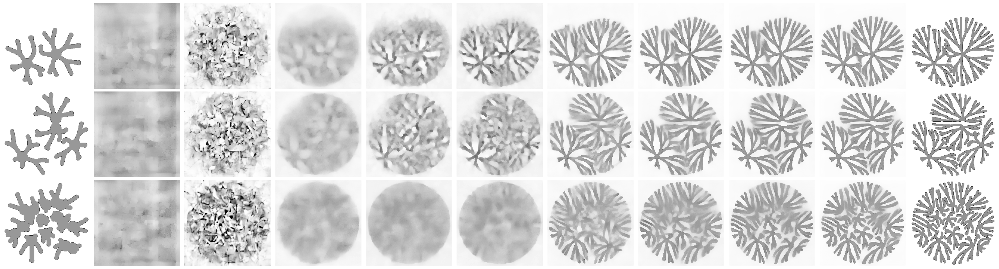

In [6]:
'''
Displaying predictions for indices 5,6,10 with a specific number of seeds(to serve as generalized illustration across whole test set)
'''
# Initialize lists to collect predictions and number of samples
pred_images_list = []
num_samples_list = []

sample_indices = [6,10,5]

# Get the input images and ground truths for the fixed samples
input_images = y3[sample_indices].cpu()  # Ensure tensors are on CPU
ground_truths = X[sample_indices].cpu()

# Loop through each model file
for filename in sorted_filenames:
    num_samples = extract_number(filename)
    num_samples_list.append(num_samples)
    
    print(f"Processing model trained with {num_samples} samples: {filename}")
    
    # Load the model
    model.load_state_dict(torch.load(os.path.join(directory, filename)))
    model.to(device)
    model.eval()
    
    with torch.no_grad():
        # Make predictions for the selected input images
        predicted_latents = model(yprime_in[sample_indices].to(device))
        # Decode the predictions
        pred_images = decode_img(predicted_latents)
        pred_images_list.append(pred_images.cpu())  # Move to CPU for plotting

# Call the plotting function
display_predictions_multiple_samples(input_images, ground_truths, pred_images_list, num_samples_list)

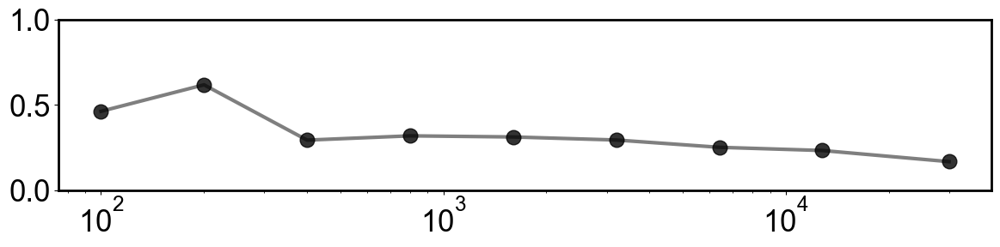

In [7]:

# Directory location where your json files are stored
directory_location = LOGS_SAVE_LOCATION


# Define a regex pattern to extract variable1 from the filenames

pattern = re.compile(r"losses_Pixel_32x32x4to32x32x4_dilRESNET_graypatterns_intermediatetocomplex_(\d+)_v1015-")

# Initialize lists to store variable1 and the corresponding last test loss
variable1_values = []
best_test_losses = []

# Iterate through the files in the directory
for filename in os.listdir(directory_location):
    if filename.endswith(".json"):
        match = pattern.match(filename)
        if match:
            variable1 = int(match.group(1))
            with open(os.path.join(directory_location, filename), 'r') as file:
                data = json.load(file)
                # get the best test loss value
                # best_test_loss = data["test_losses"][-1]
                best_test_loss = data["tolerant_loss"]
                variable1_values.append(variable1)
                best_test_losses.append(best_test_loss)

# Sort the values based on variable1 for better visualization
sorted_data = sorted(zip(variable1_values, best_test_losses))


variable1_values_sorted, best_test_losses_sorted = zip(*sorted_data)

# Plot the last test loss vs variable1 as scatter plot
fig, ax = plt.figure(figsize=(14, 6)), plt.gca()  # .set_aspect(0.5) 
ax.set_aspect(0.5)  # Set aspect ratio to 0.5

plt.plot(variable1_values_sorted, best_test_losses_sorted, '-', linewidth=3, markersize=12,color='black',alpha=0.5)
plt.plot(variable1_values_sorted, best_test_losses_sorted, 'o', linewidth=3, markersize=12,color='black',alpha=0.8)
# plt.xlabel("Training data size",fontsize=16, fontweight='bold')  # Updated x-axis label
# plt.ylabel("Loss (MSE)",fontsize=16, fontweight='bold')  # Updated y-axis label  # Validation 
plt.xscale('log')  # Use a logarithmic scale for variable1
plt.xticks(font=FPATH,fontsize=25)  # Bold x-axis tick labels
plt.yticks(font=FPATH,fontsize=25)  
plt.ylim(0,1)
# plt.grid(True, which='both', linestyle='-', linewidth=0.7, alpha=0.8)
# Make the border (spines) bold
ax.spines['top'].set_linewidth(2)
ax.spines['bottom'].set_linewidth(2)
ax.spines['left'].set_linewidth(2)
ax.spines['right'].set_linewidth(2)
ax.yaxis.set_major_locator(ticker.LinearLocator(3))